
# Developing a Deep Learning Model for Predicting Agricultural Weather Conditions and Crop Water Requirements in Hyderabad - India Using Time Series Data

## Overview
India, a country that occupies the greater part of South Asia, consists of 28 states and eight union territories, with its national capital in New Delhi. The government is a constitutional republic that represents a highly diverse population, including thousands of ethnic groups and hundreds of languages. As of 2023, India became the world’s most populous country, according to United Nations estimates.

Archaeological evidence shows that a highly sophisticated urbanized culture—the Indus civilization—dominated the northwestern part of the subcontinent from about 2600 to 2000 BCE. India has been a self-contained political and cultural arena, giving rise to a distinctive tradition primarily associated with Hinduism. Other religions like Buddhism and Jainism also originated here, contributing to India's rich intellectual life in fields such as mathematics, astronomy, architecture, literature, music, and the fine arts.

Throughout its history, India experienced incursions from beyond its northern mountain wall, significantly impacting its culture. Islam, introduced by Arab, Turkish, Persian, and other raiders from the northwest beginning early in the 8th century CE, eventually led to Muslim rule over much of the subcontinent by the 13th century. The arrival of Portuguese navigator Vasco da Gama in 1498 and the establishment of European maritime supremacy heralded major external influences, culminating in British rule. British administration began in 1858, unifying the subcontinent politically and economically. India gained independence in 1947, partitioned into India and Pakistan along religious lines.

India remains one of the world’s most ethnically diverse countries. Apart from its many religions and sects, India is home to innumerable castes and tribes and more than a dozen major linguistic groups. Efforts to instill a spirit of nationhood have been made, though tensions and violence between neighboring groups have occurred. Despite challenges, India has shown physical prosperity and cultural dynamism, evident in its infrastructure, diversified industrial base, scientific and engineering personnel, and cultural exports in music, literature, and cinema. India has three of the world’s most populous cities—Mumbai, Kolkata, and Delhi—and rapidly growing high-technology centers like Bengaluru, Chennai, and Hyderabad.

India’s geography includes the Himalayas, the Indo-Gangetic Plain, and the Deccan plateau. The Himalayas, the world's loftiest mountain system, form the northern boundary. The Indo-Gangetic Plain, stretching between the Himalayas and the Deccan, is a densely populated and agriculturally fertile area. The Deccan plateau, constituting the bulk of peninsular India, is geologically stable, with varying topography.

Hyderabad, a vibrant city in southern India, is known for its rich history, diverse culture, and rapid technological advancements. Nestled in the semi-arid region of Telangana, Hyderabad experiences a unique blend of climatic conditions that significantly influence its agriculture, economy, and daily life. The city's weather patterns, characterized by varying temperatures, humidity levels, and rainfall, play a crucial role in shaping its agricultural productivity and water resource management. With the increasing challenges posed by climate change, understanding and predicting these weather patterns have become more critical than ever.

## Research Statement
The research aims to leverage deep learning techniques to develop a robust predictive model for weather conditions in Hyderabad. By incorporating both time series and geospatial data, the study will explore trends, patterns, and correlations among various weather parameters. The primary focus will be on predicting critical weather events, such as droughts and extreme temperatures, and understanding their impact on crop water requirements. This research will not only contribute to the scientific community's understanding of weather dynamics in the semi-arid tropics but also provide valuable insights for agricultural planning and water resource management in the region.

## Data Source
The dataset for this research is provided by the International Crops Research Institute for the Semi-Arid Tropics (ICRISAT), an esteemed international non-profit organization dedicated to scientific research for development. Established in 1972, ICRISAT is headquartered in Patancheru, Hyderabad, India, and operates several regional centers across Africa, including Bamako (Mali) and Nairobi (Kenya), as well as research stations in Niamey (Niger), Kano (Nigeria), Lilongwe (Malawi), Addis Ababa (Ethiopia), and Bulawayo (Zimbabwe). India, the host country, has granted ICRISAT special status as a UN Organization, providing it with unique immunities and tax privileges.

ICRISAT has been collecting daily weather data in Hyderabad since 1978, resulting in a comprehensive dataset that spans over 40 years. This dataset includes crucial weather parameters such as maximum and minimum temperatures, relative humidity (morning and afternoon), wind speed, rainfall, bright sunshine hours, evaporation, radiation, and reference crop evapotranspiration (FAO56-ET). Additionally, it encompasses geospatial data, including longitude and latitude, enhancing the depth and scope of weather analysis.

## Research Objectives
1. Develop and validate a deep learning model to accurately predict future weather conditions using historical time series and geospatial data.
2. Analyze trends and patterns in historical weather data to identify significant seasonal and geographical variations.
3. Assess the impact of weather parameters and geographical factors on crop evapotranspiration and water requirements.
## Research Problems
1. How can a deep learning model be developed to predict future weather conditions, incorporating historical and geospatial data?
2. What trends and correlations exist in the weather data over time and across different locations?
3. How do weather and geographical factors influence crop evapotranspiration and water requirements?
   
This research will utilize ICRISAT's extensive dataset to address these objectives and problems, contributing to more informed agricultural practices and improved resource management in Hyderabad and similar semi-arid regions.

## Hypothesis
#### Objective 1: Develop and validate a deep learning model to accurately predict future weather conditions using historical time series and geospatial data.

    Null Hypothesis (H01): There is no significant relationship between historical time series data, geospatial data, and the accuracy of the deep learning model in predicting future weather conditions.
    
    Alternative Hypothesis (H11): There is a significant relationship between historical time series data, geospatial data, and the accuracy of the deep learning model in predicting future weather conditions.

#### Objective 2: Analyze trends and patterns in historical weather data to identify significant seasonal and geographical variations.

    Null Hypothesis (H02): There are no significant seasonal and geographical variations in historical weather data.
    
    Alternative Hypothesis (H12): There are significant seasonal and geographical variations in historical weather data.

#### Objective 3: Assess the impact of weather parameters and geographical factors on crop evapotranspiration and water requirements.
    
    Null Hypothesis (H03): Weather parameters and geographical factors do not significantly impact crop evapotranspiration and water requirements.
    
    Alternative Hypothesis (H13): Weather parameters and geographical factors significantly impact crop evapotranspiration and water requirements.

# Importing Libraries

In [82]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
#!pip install folium
import folium
import seaborn as sns
from sklearn.decomposition import PCA
import warnings
warnings.filterwarnings('ignore')


In [7]:
df=pd.read_excel("ICRISAT Weather 1978 to 2018.xlsx")
df.head()

,Station,Date,MaxT,MinT,RH1,RH2,Wind,Rain,SSH,Evap,Radiation,FAO56_ET,Lat,Lon,Cum_Rain
0,ICRISAT,1978-01-01,28.5,14.2,68,31.0,5.7,0.0,10.1,4.3,18.4,3.9,17.508409,78.2723,0.0
1,ICRISAT,1978-01-02,28.8,16.0,79,33.0,6.4,0.0,9.8,4.8,16.9,3.9,17.508409,78.2723,0.0
2,ICRISAT,1978-01-03,29.0,14.5,86,37.0,5.4,0.0,9.1,4.6,15.3,3.4,17.508409,78.2723,0.0
3,ICRISAT,1978-01-04,29.0,18.0,89,43.0,7.1,0.0,9.0,4.2,16.4,3.8,17.508409,78.2723,0.0
4,ICRISAT,1978-01-05,27.8,17.0,81,47.0,10.5,0.0,8.9,4.3,15.9,4.1,17.508409,78.2723,0.0


In [8]:
df.shape

(14853, 15)

In [9]:
df.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,14853,1998-05-02 00:00:00,1978-01-01 00:00:00,1988-03-02 00:00:00,1998-05-02 00:00:00,2008-07-01 00:00:00,2018-08-31 00:00:00,NaN
MaxT,14853.0,32.055807,16.5,29.0,31.0,35.0,43.5,4.115165
MinT,14853.0,19.56872,4.5,16.5,21.0,22.6,30.6,4.504939
RH1,14853.0,81.586481,17.0,75.0,87.0,93.0,100.0,15.055169
RH2,14853.0,43.550549,6.3,28.0,40.0,57.0,100.0,19.613665
Wind,14853.0,8.692278,0.2,5.2,7.6,11.2,56.0,4.795461
Rain,14853.0,2.460378,0.0,0.0,0.0,0.0,263.6,9.346085
SSH,14853.0,7.457052,0.0,5.5,8.8,10.1,12.4,3.341868
Evap,14853.0,6.420043,0.0,4.2,5.6,8.3,19.7,3.132334
Radiation,14852.0,17.877027,0.8,15.5,18.2,21.1,28.3,4.508112


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14853 entries, 0 to 14852
Data columns (total 15 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Station    14853 non-null  object        
 1   Date       14853 non-null  datetime64[ns]
 2   MaxT       14853 non-null  float64       
 3   MinT       14853 non-null  float64       
 4   RH1        14853 non-null  int64         
 5   RH2        14853 non-null  float64       
 6   Wind       14853 non-null  float64       
 7   Rain       14853 non-null  float64       
 8   SSH        14853 non-null  float64       
 9   Evap       14853 non-null  float64       
 10  Radiation  14852 non-null  float64       
 11  FAO56_ET   14853 non-null  float64       
 12  Lat        14853 non-null  float64       
 13  Lon        14853 non-null  float64       
 14  Cum_Rain   14853 non-null  float64       
dtypes: datetime64[ns](1), float64(12), int64(1), object(1)
memory usage: 1.7+ MB


The dataset comprises 14,853 entries and 15 columns, detailing various meteorological measurements. The columns include 'Station' (categorical), 'Date' (datetime), 'MaxT' and 'MinT' (maximum and minimum temperatures, respectively), 'RH1' and 'RH2' (relative humidity measurements), 'Wind' (wind speed), 'Rain' (rainfall), 'SSH' (sunshine hours), 'Evap' (evaporation), 'Radiation', 'FAO56_ET' (reference crop evapotranspiration), 'Lat' and 'Lon' (latitude and longitude), and 'Cum_Rain' (cumulative rainfall). All columns contain non-null values except for 'Radiation', which has one missing value. The data types are predominantly float64 for numerical measurements, with one integer column for relative humidity ('RH1'), and categorical ('Station') and datetime ('Date') columns. The dataset occupies approximately 1.7 MB of memory.

## Checking for missing values

In [12]:
df.isnull().sum()

Station      0
Date         0
MaxT         0
MinT         0
RH1          0
RH2          0
Wind         0
Rain         0
SSH          0
Evap         0
Radiation    1
FAO56_ET     0
Lat          0
Lon          0
Cum_Rain     0
dtype: int64

The dataset contains a total of 14,853 entries and 15 columns. Upon inspecting for missing values, it is observed that the column 'Radiation' has one missing value, while all other columns, including 'Station', 'Date', 'MaxT', 'MinT', 'RH1', 'RH2', 'Wind', 'Rain', 'SSH', 'Evap', 'FAO56_ET', 'Lat', 'Lon', and 'Cum_Rain', contain no missing values. This indicates that the dataset is largely complete, with only a single instance requiring attention for the 'Radiation' column.

In [13]:
### Checking column with missing values
df[df.isnull().any(axis=1)]

,Station,Date,MaxT,MinT,RH1,RH2,Wind,Rain,SSH,Evap,Radiation,FAO56_ET,Lat,Lon,Cum_Rain
14410,ICRISAT,2017-06-15,30.0,24.0,86,74.0,5.8,0.0,0.0,1.7,NaN,2.5,17.508409,78.2723,109.8


### Filling the missing values using simple imputer

In [15]:
numeric_cols = df.select_dtypes(include=[int, float]).columns

# Apply SimpleImputer only to numeric columns
imputer = SimpleImputer(strategy='mean')
df[numeric_cols] = imputer.fit_transform(df[numeric_cols])
df.isnull().sum()

Station      0
Date         0
MaxT         0
MinT         0
RH1          0
RH2          0
Wind         0
Rain         0
SSH          0
Evap         0
Radiation    0
FAO56_ET     0
Lat          0
Lon          0
Cum_Rain     0
dtype: int64

To handle the missing value in the 'Radiation' column, a targeted imputation strategy was employed. All numeric columns in the dataset were identified. The SimpleImputer from the sklearn.impute module was then utilized with the strategy set to 'mean', ensuring that any missing values in the numeric columns would be replaced with the mean value of the respective columns. This approach calculated the mean of each numeric column and replaced any missing values with these means. Finally, verification with df.isnull().sum() confirmed that all missing values were addressed, resulting in a complete and ready-to-use dataset.

In [16]:
df[df.isnull().any(axis=1)]


,Station,Date,MaxT,MinT,RH1,RH2,Wind,Rain,SSH,Evap,Radiation,FAO56_ET,Lat,Lon,Cum_Rain


## Checking for Outliers

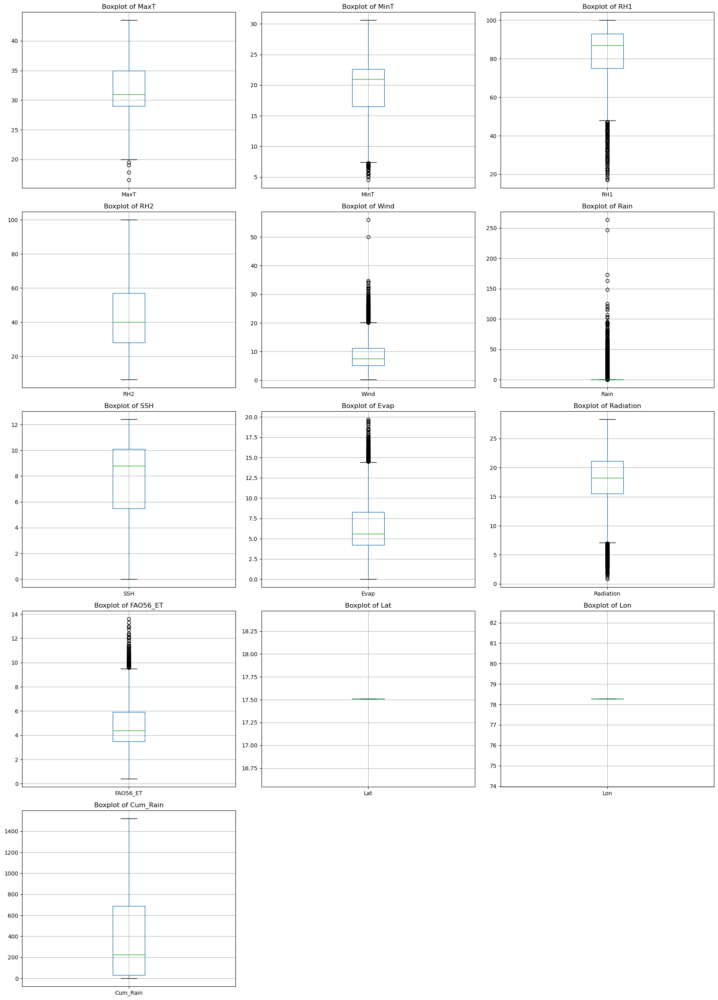

In [18]:
# Filter numeric columns
numeric_df = df.select_dtypes(include=[int, float])

# Determine the number of rows and columns for the subplots
nrows = (len(numeric_df.columns) + 2) // 3
ncols = 3

# Adjust the figure size
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(18, 5 * nrows)) 

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Create boxplots for each numeric column
for i, col in enumerate(numeric_df.columns):
    numeric_df.boxplot(column=col, ax=axes[i])
    axes[i].set_title(f'Boxplot of {col}')

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

In [19]:
#Viewing Outliers
rain_above_150_cols = df.filter(like='Rain').loc[df['Rain'] > 150]  # Filter 'Rain' like columns and select rows with Rain > 150


In [20]:
# Filter rows with Rain above 150
high_rain_rows = df[df['Rain'] > 150]

# Print entire rows
print(high_rain_rows.to_string())

       Station       Date  MaxT  MinT   RH1   RH2  Wind   Rain  SSH  Evap  Radiation  FAO56_ET        Lat      Lon  Cum_Rain
226    ICRISAT 1978-08-15  22.2  21.2  91.0  92.0  15.5  172.8  0.0   0.1        4.0       1.2  17.508409  78.2723     874.2
8270   ICRISAT 2000-08-23  26.8  19.4  98.0  84.0  15.0  263.6  0.9   1.0        8.3       2.1  17.508409  78.2723    1063.4
8271   ICRISAT 2000-08-24  23.4  18.5  98.0  98.0  14.6  246.2  0.0   0.8        2.0       0.4  17.508409  78.2723    1309.6
12587  ICRISAT 2012-06-18  31.6  20.5  91.0  53.0  11.7  163.0  0.4   3.5        8.7       3.7  17.508409  78.2723     193.8


The volume of rain as shown in the boxplot is not an outlier. Hyderabad experiences the semi arid tropical climatic conditions. The average annual rainfall is 810 mm. The south west monsoon contributes 74% of annual rainfall and north east
monsoon contributes 14%. The temperatures reaches 45º C during the summer season and with the onset of monsoons during June the temperature drop and varies between 26º C to 38º C. 

https://www.cgwb.gov.in/old_website/District_Profile/Telangana/Hyderabad.pdf 

In [22]:
# Filter rows with Rain above 150
high_Wind_rows = df[df['Wind'] > 50]

# Print entire rows
print(high_Wind_rows.to_string())

       Station       Date  MaxT  MinT   RH1   RH2  Wind  Rain  SSH  Evap  Radiation  FAO56_ET        Lat      Lon  Cum_Rain
13917  ICRISAT 2016-02-08  33.4  16.2  85.0  28.0  56.0   0.0  8.3   6.0       16.8      11.0  17.508409  78.2723       0.2


### Checking for duplicates

In [24]:
df.duplicated().sum()

0

There were no duplicates in the datasets.

### Exploratory Data Analysis (EDA)

In [26]:
df.columns

Index(['Station', 'Date', 'MaxT', 'MinT', 'RH1', 'RH2', 'Wind', 'Rain', 'SSH',
       'Evap', 'Radiation', 'FAO56_ET', 'Lat', 'Lon', 'Cum_Rain'],
      dtype='object')

### Data Point

In [28]:
m = folium.Map(location=[df['Lat'].mean(), df['Lon'].mean()], zoom_start=6)

# Adding points to the map
for idx, row in df.iterrows():
    folium.CircleMarker(
        location=[row['Lat'], row['Lon']],
        radius=5,
        popup=f"Rain: {row['Rain']} mm",
        color='blue',
        fill=True,
        fill_color='blue'
    ).add_to(m)

# Add a title to the map
title_html = '''
             <div style="position: fixed; 
             top: 10px; left: 50px; width: 300px; height: 50px; 
             background-color: white; z-index:9999; font-size:24px;">
             <b>Data Map</b>
             </div>
             '''
m.get_root().html.add_child(folium.Element(title_html))

# Saving the map to an HTML file
m.save('data_map.html')

# Display the map in a Jupyter notebook (if you're using Jupyter)
m

The dataset originates from Hyderabad, India. Notably, all the longitudes and latitudes are identical (17.508409, 78.2723), which suggests the weather data was collected from a single location or observation point within Hyderabad. This is an important factor to consider when analyzing the data, as it might not represent weather conditions across the entire city.

### Correlation heatmap

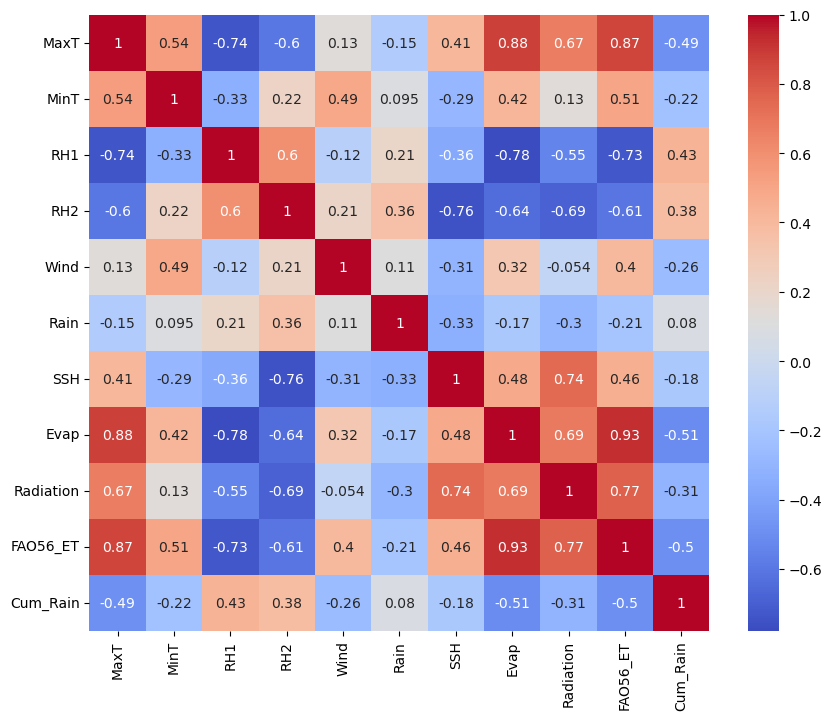

In [30]:
corr_matrix = df[['MaxT', 'MinT', 'RH1', 'RH2', 'Wind', 'Rain', 'SSH', 'Evap', 'Radiation', 'FAO56_ET', 'Cum_Rain']].corr()
# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()

The figures represent a correlation matrix for several weather-related variables. Each value shows the Pearson correlation coefficient between pairs of variables. A value of 1.0 indicates a perfect positive correlation, -1.0 indicates a perfect negative correlation, and 0 indicates no correlation. For instance, MaxT (maximum temperature) has a strong positive correlation with Evap (evaporation) at 0.876, meaning higher temperatures are associated with higher evaporation rates. Conversely, MaxT has a strong negative correlation with RH1 (relative humidity in the morning) at -0.737, indicating that higher temperatures tend to occur with lower morning humidity. MinT (minimum temperature) shows moderate correlations with several variables, like MaxT at 0.537 and FAO56_ET (reference crop evapotranspiration) at 0.505. Rainfall (Rain) has weaker correlations with most variables, with the highest being a moderate positive correlation with RH2 (relative humidity in the afternoon) at 0.356. SSH (bright sunshine hours) negatively correlates with both relative humidity measures and positively with variables like Radiation at 0.744, suggesting that more sunshine is linked with higher radiation levels but lower humidity. Overall, the matrix reveals how different climatic variables are interrelated, highlighting both direct and inverse relationships.

### Identifying any whether patterns in Hyderabad - Kmeans clustering

In [32]:
scaler = StandardScaler()
scaled_df = scaler.fit_transform(df[['MaxT', 'MinT', 'RH1', 'RH2', 'Wind', 'Rain', 'SSH', 'Evap', 'Radiation', 'FAO56_ET', 'Cum_Rain']])

In [33]:
columns=('MaxT', 'MinT', 'RH1', 'RH2', 'Wind', 'Rain', 'SSH', 'Evap', 'Radiation', 'FAO56_ET', 'Cum_Rain')
scaled_df=pd.DataFrame(scaled_df, columns=columns)
scaled_df.head()

,MaxT,MinT,RH1,RH2,Wind,Rain,SSH,Evap,Radiation,FAO56_ET,Cum_Rain
0,-0.864103,-1.191781,-0.902477,-0.639910,-0.624002,-0.263261,0.790886,-0.676848,0.116015,-0.500238,-0.968217
1,-0.791199,-0.792206,-0.171806,-0.537936,-0.478026,-0.263261,0.701113,-0.517217,-0.216741,-0.500238,-0.968217
2,-0.742597,-1.125185,0.293166,-0.333990,-0.686564,-0.263261,0.491642,-0.581070,-0.571681,-0.775427,-0.968217
3,-0.742597,-0.348234,0.492440,-0.028071,-0.332050,-0.263261,0.461718,-0.708774,-0.327660,-0.555276,-0.968217
4,-1.034211,-0.570220,-0.038957,0.175876,0.376978,-0.263261,0.431793,-0.676848,-0.438578,-0.390163,-0.968217


### Principal components

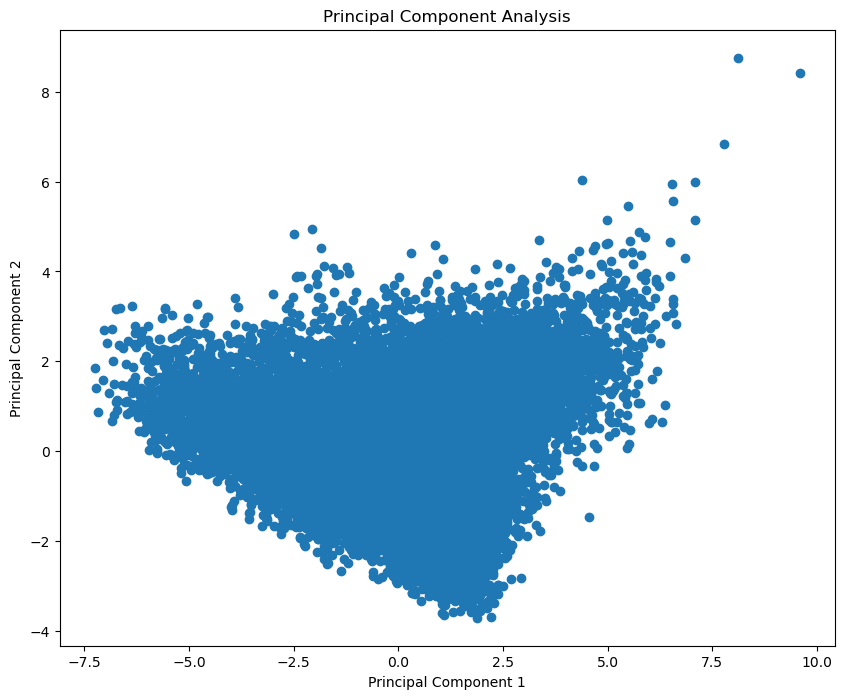

In [35]:
pca = PCA(n_components=2)
principal_components = pca.fit_transform(scaled_df)

# Create a DataFrame with the principal components
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])

# Plot the principal components
plt.figure(figsize=(10, 8))
plt.scatter(pca_df['PC1'], pca_df['PC2'])
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Principal Component Analysis')
plt.show()

We used Principal Component Analysis (PCA) before fitting the components on KMeans to reduce the dimensionality of the dataset while retaining most of the original variance. By transforming the data into two principal components, PCA simplifies the dataset, making it easier to visualize and interpret in a 2D space. This step helps in removing noise and irrelevant features, thereby improving the clustering performance and efficiency of KMeans. Additionally, it ensures that the clustering algorithm focuses on the most significant patterns and variations within the data, leading to more meaningful and distinct clusters. This approach also aids in overcoming the curse of dimensionality, which can negatively impact the performance of clustering algorithms in high-dimensional spaces.

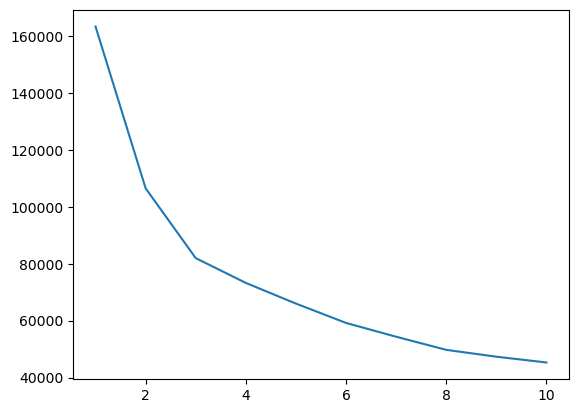

In [84]:
inertia_scores3=[]
for i in range (1,11):
    kmeans=KMeans(n_clusters=i)
    kmeans.fit(scaled_df)
    inertia_scores3.append(kmeans.inertia_)
plt.plot(range(1,11), inertia_scores3)

We used the Elbow method in KMeans to determine the optimal number of clusters by evaluating the within-cluster sum of squares (WCSS) for different cluster counts. The Elbow method involves plotting the WCSS against the number of clusters and identifying the point where the rate of decrease sharply slows, forming an "elbow." This point indicates the number of clusters that balance the trade-off between minimizing WCSS and avoiding overfitting. In your case, the Elbow method suggested that 3 clusters were optimal, as the WCSS significantly decreased up to 3 clusters and then showed a more gradual decline. This choice of 3 clusters ensures a meaningful partitioning of the data, capturing distinct groupings without unnecessary complexity.

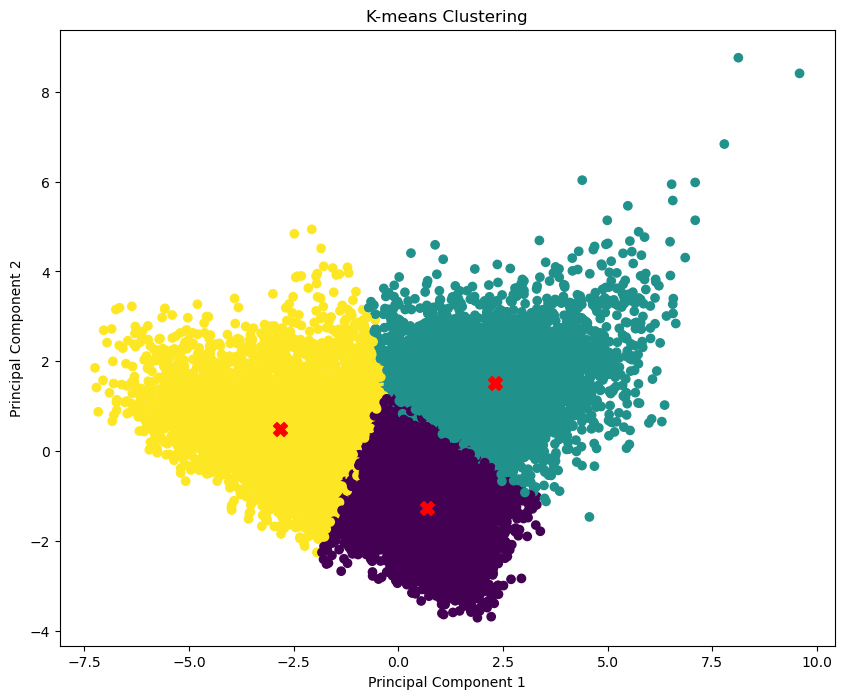

In [86]:
from sklearn.cluster import KMeans

# Apply K-means clustering
kmeans = KMeans(n_clusters=3)
kmeans.fit(scaled_df)
df['Cluster'] = kmeans.labels_
centroids = kmeans.cluster_centers_
centroids_pca = pca.transform(centroids)


# Visualize the clusters using the principal components
plt.figure(figsize=(10, 8))
plt.scatter(pca_df['PC1'], pca_df['PC2'], c=df['Cluster'], cmap='viridis')
plt.scatter(x=centroids_pca[:, 0], y=centroids_pca[:, 1], s=100, marker="X", c="red")
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('K-means Clustering')
plt.show()

The output is a scatter plot showing the results of KMeans clustering applied to a dataset that has been reduced to two principal components using PCA. Each point represents a data sample, plotted according to its values on the first two principal components. The colors indicate the clusters assigned by the KMeans algorithm, with three distinct clusters visible (yellow, purple, and teal). The red 'X' markers represent the centroids of each cluster, which are the central points calculated by the KMeans algorithm. These centroids are used to assign each data point to a cluster based on the shortest Euclidean distance to the centroid. This visualization helps to understand the separation and distribution of the clusters in a two-dimensional space. The clear separation between the colors indicates that the KMeans algorithm has effectively partitioned the data into three clusters. 

In [90]:
df.columns

Index(['Station', 'Date', 'MaxT', 'MinT', 'RH1', 'RH2', 'Wind', 'Rain', 'SSH',
       'Evap', 'Radiation', 'FAO56_ET', 'Lat', 'Lon', 'Cum_Rain', 'Cluster'],
      dtype='object')

#### Distribution plot

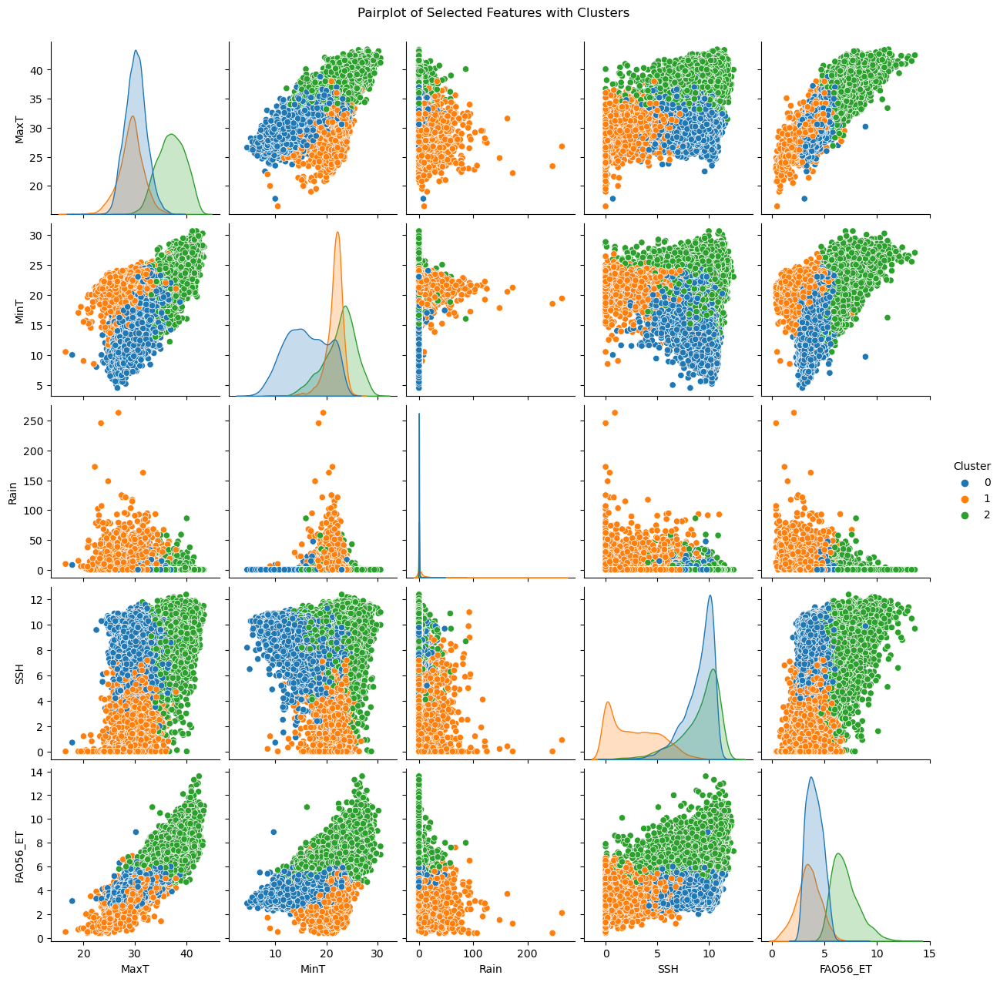

In [95]:
# Pair plot with clusters
sns.pairplot(df[['MaxT', 'MinT', 'Rain', 'SSH', 'FAO56_ET', 'Cluster']], hue='Cluster', palette='tab10')
plt.suptitle('Pairplot of Selected Features with Clusters', y=1.02)
plt.show()

The  pair plots offer a comprehensive view of the interactions between key climatic variables and how they vary across different clusters. This analysis helps in understanding the underlying patterns and relationships within the climate data, which can be valuable for further studies and decision-making related to climate and environmental management. The scatter plots illustrate the relationships between each pair of variables, while the density plots on the diagonal show the distribution of individual variables within each cluster. Key observations include a positive correlation between MaxT and FAO56_ET, and between MinT and FAO56_ET. The rain variable shows a more scattered pattern with other variables, indicating less consistent relationships. The clusters show distinct groupings in the scatter plots, suggesting varying climatic conditions captured by each cluster.

### Seasonal Analysis

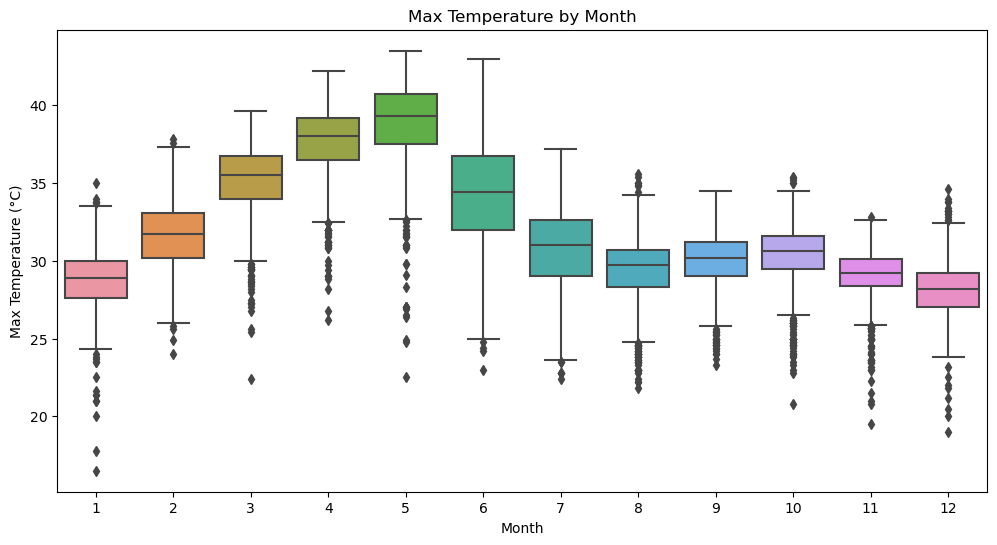

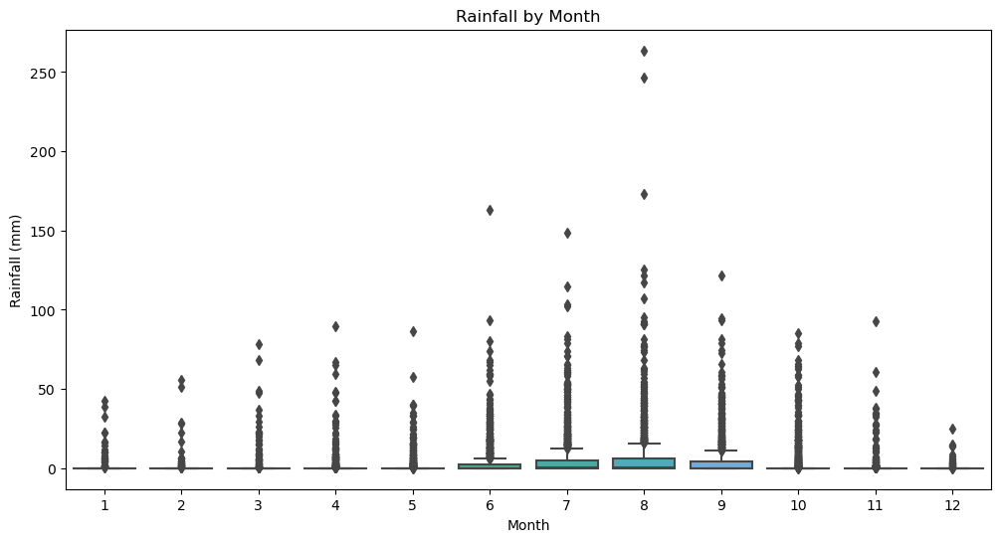

In [99]:
# Extract month and year
df['Month'] = df['Date'].dt.month
df['Year'] = df['Date'].dt.year

# Boxplot of MaxT by Month
plt.figure(figsize=(12, 6))
sns.boxplot(x='Month', y='MaxT', data=df)
plt.title('Max Temperature by Month')
plt.xlabel('Month')
plt.ylabel('Max Temperature (°C)')
plt.show()

# Boxplot of Rain by Month
plt.figure(figsize=(12, 6))
sns.boxplot(x='Month', y='Rain', data=df)
plt.title('Rainfall by Month')
plt.xlabel('Month')
plt.ylabel('Rainfall (mm)')
plt.show()


The output consists of two box plots illustrating the distribution of maximum temperature and rainfall by month. The top plot shows that maximum temperatures generally increase from January to June, peaking around April to June, and then decrease towards December. The variability in maximum temperatures is higher during the hotter months (April to June). The bottom plot reveals that rainfall peaks significantly in August, with a high number of outliers indicating occasional heavy rain events. Median rainfall is relatively low for most months, with increased variability and more frequent outliers in the middle of the year, particularly in August. Overall, these plots highlight seasonal patterns where temperatures rise mid-year and rainfall peaks in August, providing valuable insights into weather trends for planning and analysis.

### Wind Speed per Cluster

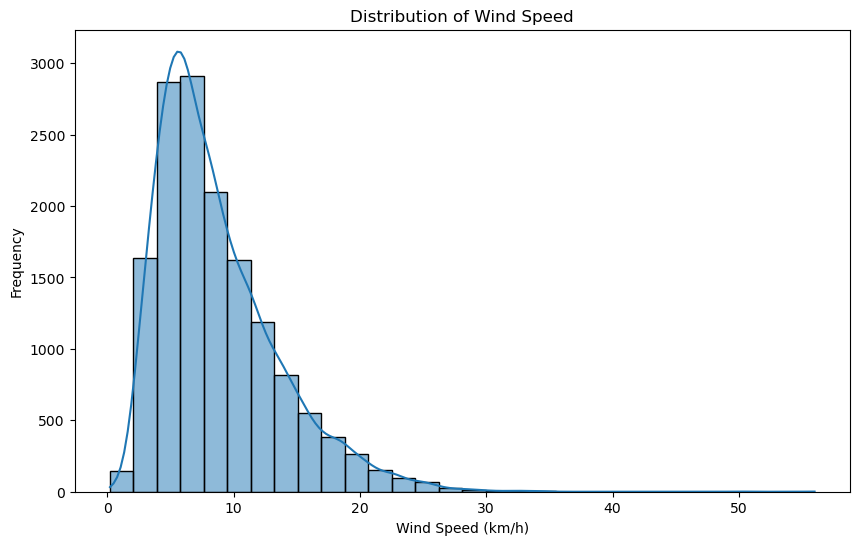

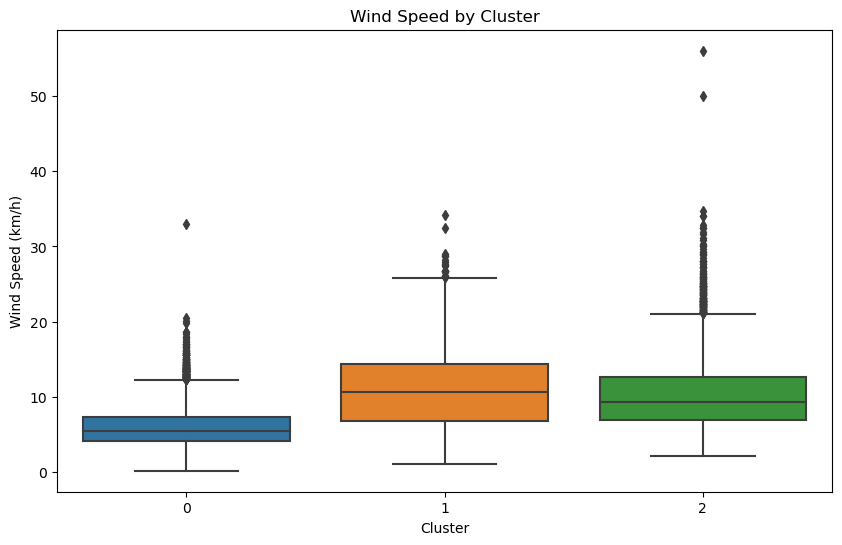

In [103]:
# Wind speed distribution
plt.figure(figsize=(10, 6))
sns.histplot(df['Wind'], kde=True, bins=30)
plt.title('Distribution of Wind Speed')
plt.xlabel('Wind Speed (km/h)')
plt.ylabel('Frequency')
plt.show()

# Boxplot of Wind by Cluster
plt.figure(figsize=(10, 6))
sns.boxplot(x='Cluster', y='Wind', data=df)
plt.title('Wind Speed by Cluster')
plt.xlabel('Cluster')
plt.ylabel('Wind Speed (km/h)')
plt.show()

The provided plots consist of two visualizations focusing on wind speed data. The top plot is a histogram displaying the distribution of wind speed (km/h). It shows that most wind speed values are clustered around the lower end, particularly between 0 and 10 km/h, indicating a right-skewed distribution with fewer occurrences of higher wind speeds. The bottom plot is a box plot showing the distribution of wind speeds across different clusters identified by a KMeans clustering algorithm. It highlights variations in wind speed among the clusters, with Cluster 1 having the widest range and highest median wind speed, followed by Cluster 2 and Cluster 0. The presence of outliers in all clusters indicates occasional instances of unusually high wind speeds. Together, these plots provide insights into the general distribution of wind speeds and their relationship with the identified clusters.

### Time series analysis

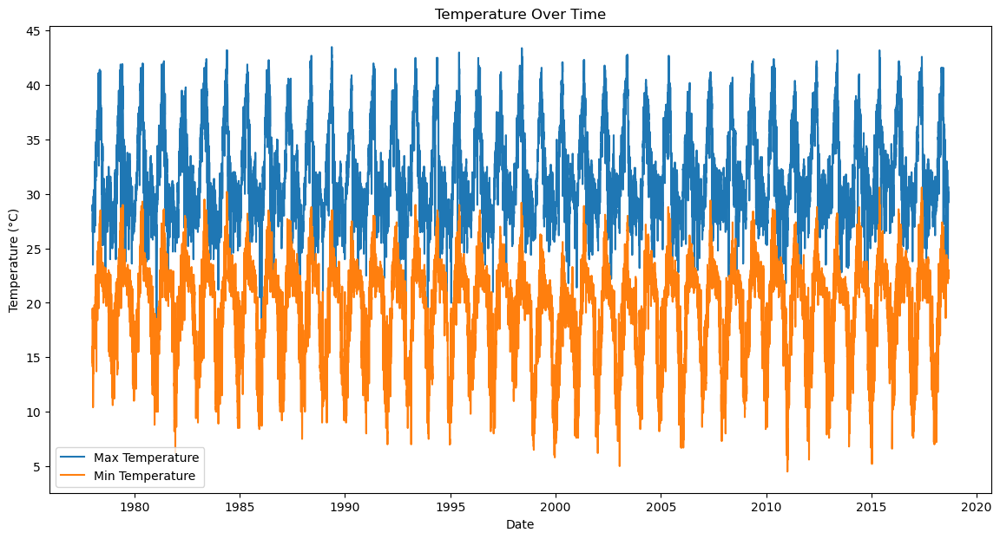

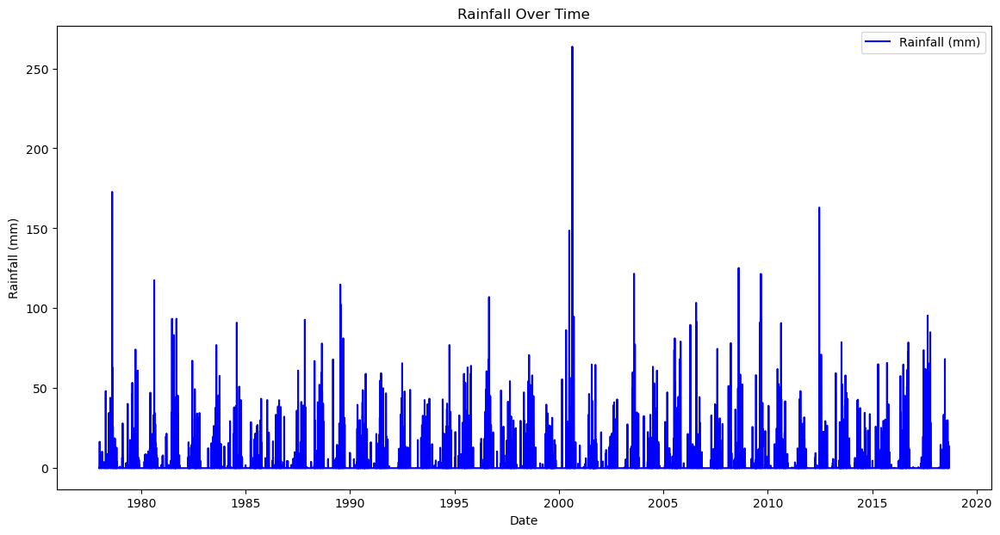

In [109]:
df['Date'] = pd.to_datetime(df['Date'])

# Plot MaxT and MinT over time
plt.figure(figsize=(14, 7))
plt.plot(df['Date'], df['MaxT'], label='Max Temperature')
plt.plot(df['Date'], df['MinT'], label='Min Temperature')
plt.xlabel('Date')
plt.ylabel('Temperature (°C)')
plt.title('Temperature Over Time')
plt.legend()
plt.show()

# Plot Rain over time
plt.figure(figsize=(14, 7))
plt.plot(df['Date'], df['Rain'], label='Rainfall (mm)', color='b')
plt.xlabel('Date')
plt.ylabel('Rainfall (mm)')
plt.title('Rainfall Over Time')
plt.legend()
plt.show()

The  plots shows the variation in maximum and minimum temperatures from 1980 to 2020. The blue line represents the maximum temperature, while the orange line represents the minimum temperature. The plot highlights a clear annual cycle in both maximum and minimum temperatures, with temperatures peaking around mid-year and reaching their lowest towards the end of the year. Over the years, there appears to be a slight upward trend in both maximum and minimum temperatures, indicating a possible warming trend over the four-decade period.

The bottom plot displays the rainfall data (in millimeters) over the same time period. The plot shows a highly variable pattern with occasional spikes indicating periods of heavy rainfall. Notably, there is a significant spike around the year 2000, suggesting an exceptionally high rainfall event. Hyderabad reported significant rainfall in 2000. News reports and historical accounts mention heavy downpours, particularly in August 2000. Begumpet, a specific area within Hyderabad, saw a staggering 241.5 mm (almost 24 cm) of rain in just one day, contributing to widespread flooding. This intense downpour suggests Hyderabad likely received above-average rainfall throughout 2000. Overall, the rainfall data does not exhibit a clear trend but rather shows sporadic high rainfall events throughout the years.
https://indianexpress.com/article/cities/hyderabad/hyderabad-rains-floods-waterlogging-urbanisation-6798417/ 